<a href="https://colab.research.google.com/github/vnvalay/test/blob/main/uga.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Подключение библиотек

In [1]:
import pandas as pd
import numpy as np

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns

In [153]:
import statsmodels.api as sm
from statsmodels.formula.api import ols

In [157]:
from scipy.stats import boxcox

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
from IPython.display import HTML
style = "<style>svg{width:200% !important;height:200% !important;}</style>"
HTML(style)

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
import plotly.express as px
import plotly.graph_objs as go

In [181]:
import plotly.io as pio
pio.renderers.default='notebook'

In [8]:
import json

# Загрузка и анализ данных

In [9]:
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/us events ad_revenue filtered 03.02-07.02.csv')

In [10]:
df.head(10)

,profile_id,os_version,device_manufacturer,device_model,device_type,device_locale,event_name,event_json,event_datetime,event_timestamp,event_receive_datetime,event_receive_timestamp,connection_type,operator_name,country_iso_code,city
0,JLjpGzDHBQm,11,Samsung,Galaxy Tab S6,tablet,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-04 20:02:28,1643994148,2022-02-06 17:58:19,1644159499,wifi,NaN,US,Norwalk
1,JLjpGzDHBQm,11,Samsung,Galaxy Tab S6,tablet,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-04 20:02:45,1643994165,2022-02-06 17:58:19,1644159499,wifi,NaN,US,Norwalk
2,JLkVacrzHY6,11,Google,Pixel 2,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-05 17:53:05,1644072785,2022-02-06 16:59:29,1644155969,wifi,Verizon,US,Charlotte
3,JMC6wG3cX0f,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""int"",""placement"":""next_level"",""vie...",2022-02-06 17:09:01,1644156541,2022-02-06 17:09:24,1644156564,wifi,T-Mobile,US,Cocoa
4,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:15:38,1644156938,2022-02-06 17:16:16,1644156976,cell,Verizon,US,NaN
5,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:15:53,1644156953,2022-02-06 17:16:16,1644156976,cell,Verizon,US,NaN
6,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:16:03,1644156963,2022-02-06 17:16:16,1644156976,cell,Verizon,US,NaN
7,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:16:23,1644156983,2022-02-06 17:17:11,1644157031,cell,Verizon,US,NaN
8,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:16:33,1644156993,2022-02-06 17:17:11,1644157031,cell,Verizon,US,NaN
9,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:16:53,1644157013,2022-02-06 17:17:11,1644157031,cell,Verizon,US,NaN


In [14]:
fig = go.Figure()
fig.add_trace(go.Pie(values=df.os_version, labels=df.os_version))
fig.show()

In [15]:
df.profile_id.value_counts()

JL5pmKYe8g7    8486
JLTfZhBE0e3    6571
JL4p0t068V1    5646
JLnrqVfS2Fn    5046
JLxjvw18Qg0    4934
               ... 
JLm6svXrHwU       1
JLytQqxhsuN       1
JLwa1Kxkn6k       1
JMEFrO5FntC       1
JLgvPJq1sOV       1
Name: profile_id, Length: 4226, dtype: int64

In [16]:
df = df.dropna(axis='index', how='any', subset=['profile_id'])

In [17]:
df.isna().sum()

profile_id                      0
os_version                      0
device_manufacturer             0
device_model                    0
device_type                     0
device_locale                   0
event_name                      0
event_json                      0
event_datetime                  0
event_timestamp                 0
event_receive_datetime          0
event_receive_timestamp         0
connection_type                 0
operator_name               18879
country_iso_code                0
city                       323694
dtype: int64

In [18]:
df.event_json[0]

'{"ad_type":"banner","placement":"","view_index":1,"session_view_index":0,"cur_ticks":637795729492245130,"session_length":705.8807,"revenue":0.000510313,"ads_ltv":0.487876676518837,"ecpm_sma":0.511508107185364,"normalized_ecpm_sma":0.511508107185364,"value":0.000510313,"currency":"USD","ad_country_code":"US","network_name":"Google AdMob","ad_unit_id":"64c6b1114ea8c1cc","ad_network_placement":"ca-app-pub-7511632782617496/8825263691","creativeId":"CJ3XirfD5vUCFYPnKAUdG3MOYQ"}'

In [19]:
a = df.event_json.apply(json.loads).values.tolist()

In [20]:
js_df = pd.DataFrame.from_records(a)

In [21]:
js_df.head(10)

,ad_type,placement,view_index,session_view_index,cur_ticks,session_length,revenue,ads_ltv,ecpm_sma,normalized_ecpm_sma,value,currency,ad_country_code,network_name,ad_unit_id,ad_network_placement,creativeId
0,banner,,1,0,637795729492245130,705.88070,0.000510,0.487877,0.511508,0.511508,0.000510,USD,US,Google AdMob,64c6b1114ea8c1cc,ca-app-pub-7511632782617496/8825263691,CJ3XirfD5vUCFYPnKAUdG3MOYQ
1,banner,,1,0,637795729659949790,722.65120,0.000510,0.488387,0.511389,0.511389,0.000510,USD,US,Google AdMob,64c6b1114ea8c1cc,ca-app-pub-7511632782617496/8825263691,CNa-lL_D5vUCFZrpKAUdU2QBDQ
2,banner,,1,0,637796515863735930,431.81290,0.002386,0.678479,0.928597,0.928597,0.002386,USD,US,APPLOVIN_EXCHANGE,64c6b1114ea8c1cc,banner_regular,pandora-58
3,int,next_level,1,1,637797353426827330,125.94960,0.013894,0.013894,13.782633,13.893784,0.013894,USD,US,AppLovin,3ab7705b07ebb75f,inter_regular,13045364
4,banner,,1,0,637797357392197840,12.71129,0.006828,0.060571,1.660282,1.660282,0.006828,USD,US,Google AdMob,64c6b1114ea8c1cc,ca-app-pub-7511632782617496/6197324251,CMTi5e-h6_UCFUdVwQodt9EIMw
5,banner,,1,0,637797357542806540,27.75300,0.000494,0.061065,1.543673,1.543673,0.000494,USD,US,Google AdMob,64c6b1114ea8c1cc,ca-app-pub-7511632782617496/8825263691,CKjDtPSh6_UCFV-DywEd7-gBAQ
6,banner,,1,0,637797357641550460,37.62716,0.002386,0.063451,1.627922,1.627922,0.002386,USD,US,APPLOVIN_EXCHANGE,64c6b1114ea8c1cc,banner_regular,pandora-58
7,banner,,1,0,637797357843375100,57.81027,0.000494,0.063945,1.514549,1.514549,0.000494,USD,US,Google AdMob,64c6b1114ea8c1cc,ca-app-pub-7511632782617496/8825263691,CPTz84Ki6_UCFUp2wQodL68LZw
8,banner,,1,0,637797357941529010,67.62502,0.002386,0.066332,1.601711,1.601711,0.002386,USD,US,APPLOVIN_EXCHANGE,64c6b1114ea8c1cc,banner_regular,pandora-57
9,banner,,1,0,637797358143310010,87.80360,0.000494,0.066826,1.490959,1.490959,0.000494,USD,US,Google AdMob,64c6b1114ea8c1cc,ca-app-pub-7511632782617496/8825263691,COaY9ZCi6_UCFRN3wQodXY4GCg


In [22]:
js_df.ad_country_code.value_counts()

US    859948
ID        42
DE        41
FR        14
CA        10
KR         4
GB         2
EG         2
MX         2
Name: ad_country_code, dtype: int64

In [23]:
js_df.isna().sum()

ad_type                 0
placement               0
view_index              0
session_view_index      0
cur_ticks               0
session_length          0
revenue                 0
ads_ltv                 0
ecpm_sma                0
normalized_ecpm_sma     0
value                   0
currency                0
ad_country_code         0
network_name            0
ad_unit_id              0
ad_network_placement    0
creativeId              0
dtype: int64

## 1

In [24]:
ecpm_df = df.copy()

In [25]:
ecpm_df['ad_type'] = js_df.ad_type

In [26]:
ecpm_df['ecpm'] = js_df.ecpm_sma

In [27]:
ecpm_df.head(10)

,profile_id,os_version,device_manufacturer,device_model,device_type,device_locale,event_name,event_json,event_datetime,event_timestamp,event_receive_datetime,event_receive_timestamp,connection_type,operator_name,country_iso_code,city,ad_type,ecpm
0,JLjpGzDHBQm,11,Samsung,Galaxy Tab S6,tablet,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-04 20:02:28,1643994148,2022-02-06 17:58:19,1644159499,wifi,NaN,US,Norwalk,banner,0.511508
1,JLjpGzDHBQm,11,Samsung,Galaxy Tab S6,tablet,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-04 20:02:45,1643994165,2022-02-06 17:58:19,1644159499,wifi,NaN,US,Norwalk,banner,0.511389
2,JLkVacrzHY6,11,Google,Pixel 2,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-05 17:53:05,1644072785,2022-02-06 16:59:29,1644155969,wifi,Verizon,US,Charlotte,banner,0.928597
3,JMC6wG3cX0f,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""int"",""placement"":""next_level"",""vie...",2022-02-06 17:09:01,1644156541,2022-02-06 17:09:24,1644156564,wifi,T-Mobile,US,Cocoa,int,13.782633
4,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:15:38,1644156938,2022-02-06 17:16:16,1644156976,cell,Verizon,US,NaN,banner,1.660282
5,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:15:53,1644156953,2022-02-06 17:16:16,1644156976,cell,Verizon,US,NaN,banner,1.543673
6,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:16:03,1644156963,2022-02-06 17:16:16,1644156976,cell,Verizon,US,NaN,banner,1.627922
7,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:16:23,1644156983,2022-02-06 17:17:11,1644157031,cell,Verizon,US,NaN,banner,1.514549
8,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:16:33,1644156993,2022-02-06 17:17:11,1644157031,cell,Verizon,US,NaN,banner,1.601711
9,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:16:53,1644157013,2022-02-06 17:17:11,1644157031,cell,Verizon,US,NaN,banner,1.490959


In [28]:
ecpm_df.dropna(subset=['ecpm', 'ad_type'], inplace=True)
ecpm_df.isna().sum()

profile_id                      0
os_version                      0
device_manufacturer             0
device_model                    0
device_type                     0
device_locale                   0
event_name                      0
event_json                      0
event_datetime                  0
event_timestamp                 0
event_receive_datetime          0
event_receive_timestamp         0
connection_type                 0
operator_name               18879
country_iso_code                0
city                       323694
ad_type                         0
ecpm                            0
dtype: int64

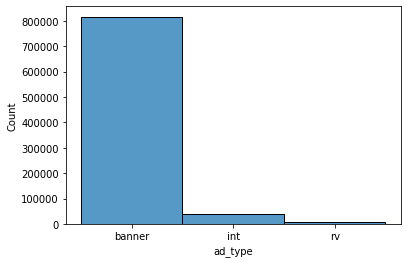

In [29]:
sns.histplot(ecpm_df.ad_type)

In [30]:
fig = go.Figure()
fig.add_trace(go.Pie(labels=ecpm_df.ad_type))
fig.show()

In [31]:
ecpm_df.isna().sum()

profile_id                      0
os_version                      0
device_manufacturer             0
device_model                    0
device_type                     0
device_locale                   0
event_name                      0
event_json                      0
event_datetime                  0
event_timestamp                 0
event_receive_datetime          0
event_receive_timestamp         0
connection_type                 0
operator_name               18879
country_iso_code                0
city                       323694
ad_type                         0
ecpm                            0
dtype: int64

In [32]:
ad_type_list = ['banner', 'int', 'rv']

In [33]:
ecpm_df

,profile_id,os_version,device_manufacturer,device_model,device_type,device_locale,event_name,event_json,event_datetime,event_timestamp,event_receive_datetime,event_receive_timestamp,connection_type,operator_name,country_iso_code,city,ad_type,ecpm
0,JLjpGzDHBQm,11,Samsung,Galaxy Tab S6,tablet,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-04 20:02:28,1643994148,2022-02-06 17:58:19,1644159499,wifi,NaN,US,Norwalk,banner,0.511508
1,JLjpGzDHBQm,11,Samsung,Galaxy Tab S6,tablet,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-04 20:02:45,1643994165,2022-02-06 17:58:19,1644159499,wifi,NaN,US,Norwalk,banner,0.511389
2,JLkVacrzHY6,11,Google,Pixel 2,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-05 17:53:05,1644072785,2022-02-06 16:59:29,1644155969,wifi,Verizon,US,Charlotte,banner,0.928597
3,JMC6wG3cX0f,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""int"",""placement"":""next_level"",""vie...",2022-02-06 17:09:01,1644156541,2022-02-06 17:09:24,1644156564,wifi,T-Mobile,US,Cocoa,int,13.782633
4,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:15:38,1644156938,2022-02-06 17:16:16,1644156976,cell,Verizon,US,NaN,banner,1.660282
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
860060,JLSQY2nx1NQ,12,Samsung,Galaxy S21 Ultra 5G,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-03 08:26:03,1643865963,2022-02-03 08:26:14,1643865974,wifi,Verizon,US,Elmira,banner,0.080914
860061,JLSQY2nx1NQ,12,Samsung,Galaxy S21 Ultra 5G,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-03 08:26:12,1643865972,2022-02-03 08:26:14,1643865974,wifi,Verizon,US,Elmira,banner,3.379858
860062,JLSQY2nx1NQ,12,Samsung,Galaxy S21 Ultra 5G,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-03 08:26:27,1643865987,2022-02-03 08:27:36,1643866056,wifi,Verizon,US,Elmira,banner,3.319878
860063,JLSQY2nx1NQ,12,Samsung,Galaxy S21 Ultra 5G,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-03 08:26:42,1643866002,2022-02-03 08:27:36,1643866056,wifi,Verizon,US,Elmira,banner,3.265896


In [34]:
for i in ad_type_list:
  low = ecpm_df[ecpm_df.ad_type == i].ecpm.quantile(.1)
  high = ecpm_df[ecpm_df.ad_type == i].ecpm.quantile(.9)
  ecpm_df.drop(ecpm_df[(ecpm_df.ad_type == i) & ((ecpm_df.ecpm < low) | (ecpm_df.ecpm > high))].index, inplace=True)

In [35]:
gr = ecpm_df.groupby(['profile_id', 'ad_type']).agg({'ecpm': 'mean'}).sort_values('ecpm')
gr.reset_index(inplace=True)
gr

,profile_id,ad_type,ecpm
0,JL06OWhBYxn,banner,0.038162
1,JMJPQkTeATb,banner,0.043831
2,JMBhsYvXmw3,banner,0.044362
3,JLseF0nnBHD,banner,0.044490
4,JLzXixXA8tp,banner,0.048396
...,...,...,...
7811,JLxABjWZRBT,rv,201.302429
7812,JLwx1Z3diNb,rv,201.394852
7813,JLmYdB9k15m,rv,202.476644
7814,JLsDxQt3u05,rv,203.334401


In [36]:
gr.head(15)

,profile_id,ad_type,ecpm
0,JL06OWhBYxn,banner,0.038162
1,JMJPQkTeATb,banner,0.043831
2,JMBhsYvXmw3,banner,0.044362
3,JLseF0nnBHD,banner,0.044490
4,JLzXixXA8tp,banner,0.048396
5,JLmh2VZNEMr,banner,0.052075
6,JMCdFg0r4xG,banner,0.053761
7,JLjX3ELxz8O,banner,0.054957
8,JLLRTkOTp3A,banner,0.055601
9,JMKnrRkcAjt,banner,0.058976


### 1a

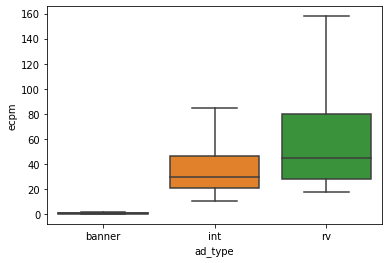

In [37]:
sns.boxplot(x='ad_type', y='ecpm', data=gr, showfliers = False)

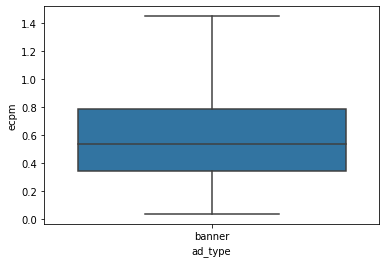

In [38]:
sns.boxplot(x=gr.ad_type[gr.ad_type == 'banner'], y='ecpm', data=gr, showfliers = False)

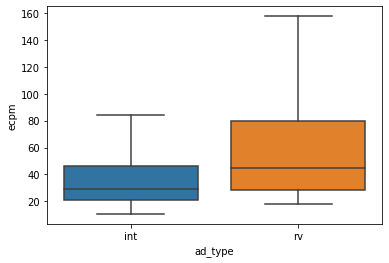

In [39]:
sns.boxplot(x=gr.ad_type[(gr.ad_type == 'int') | (gr.ad_type == 'rv')], y='ecpm', data=gr, showfliers = False)

In [119]:
plt.rcParams['figure.dpi'] = 140

In [94]:
gr

,profile_id,ad_type,ecpm
0,JL06OWhBYxn,banner,0.038162
1,JMJPQkTeATb,banner,0.043831
2,JMBhsYvXmw3,banner,0.044362
3,JLseF0nnBHD,banner,0.044490
4,JLzXixXA8tp,banner,0.048396
...,...,...,...
7811,JLxABjWZRBT,rv,201.302429
7812,JLwx1Z3diNb,rv,201.394852
7813,JLmYdB9k15m,rv,202.476644
7814,JLsDxQt3u05,rv,203.334401


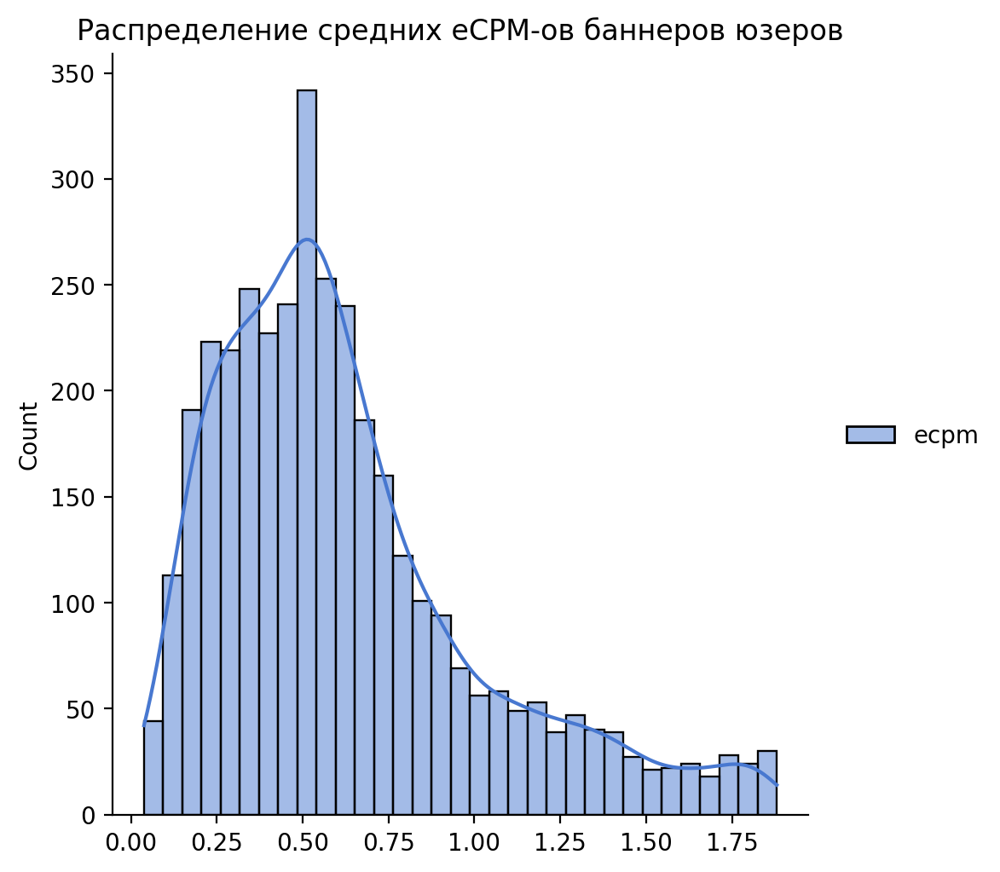

In [116]:
sns.displot(data=gr[gr.ad_type == 'banner'], kde=True, palette='muted').set(title='Pаспределение средних eCPM-ов баннеров юзеров')

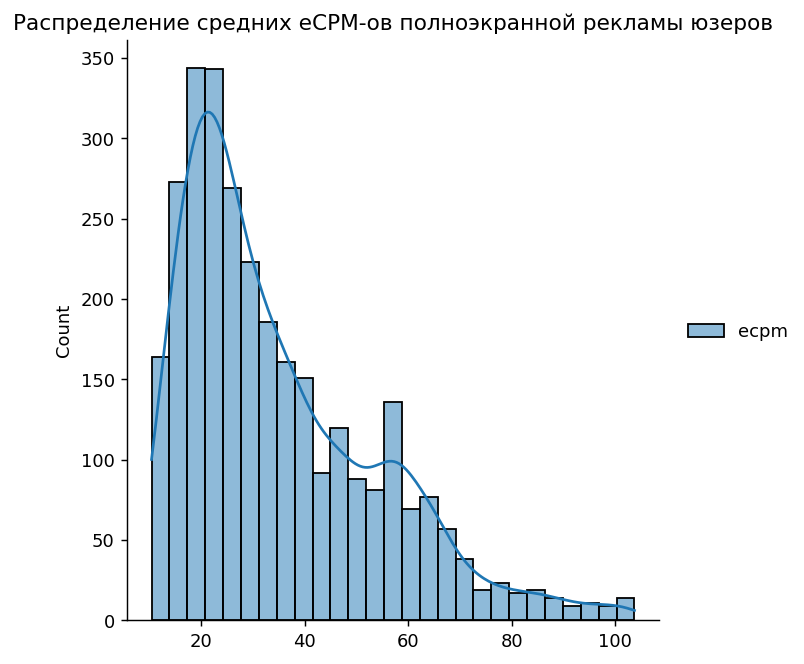

In [118]:
sns.displot(data=gr[gr.ad_type == 'int'], kde=True).set(title='Pаспределение средних eCPM-ов полноэкранной рекламы юзеров')

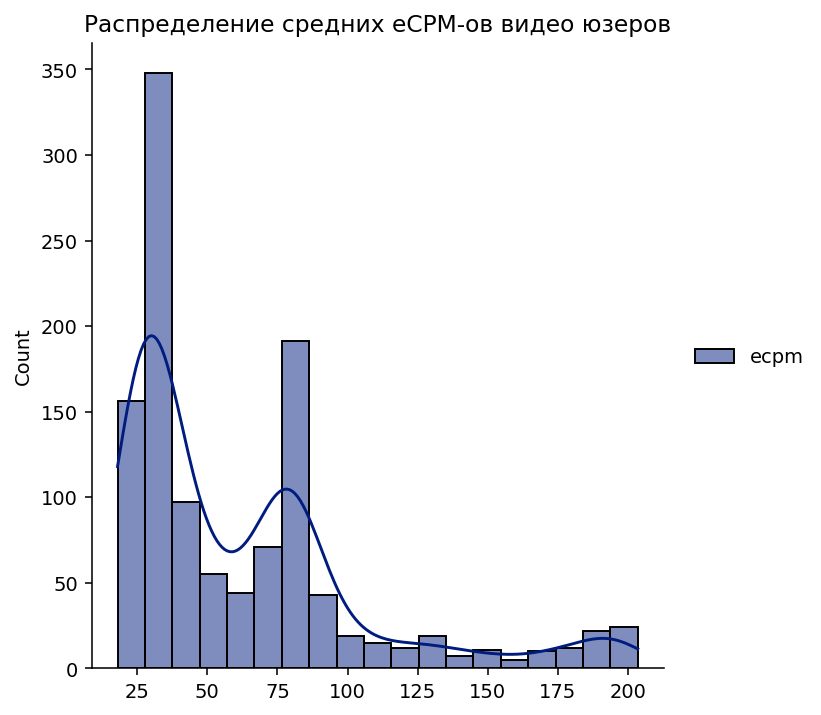

In [120]:
sns.displot(data=gr[gr.ad_type == 'rv'], kde=True, palette='dark').set(title='Pаспределение средних eCPM-ов видео юзеров')

### 1b

In [132]:
avg_city_ecpm = ecpm_df[ecpm_df.ad_type.isin(['int', 'rv'])].groupby(['ad_type', 'city']).agg({'ecpm': 'mean'}).reset_index()

In [133]:
top_avg_city_ecpm_list = avg_city_ecpm[avg_city_ecpm.ad_type.isin(['int', 'rv'])].groupby('city').agg({'ecpm': 'sum'}).sort_values(by='ecpm', ascending=False).reset_index().head(10)
top_avg_city_ecpm_list = top_avg_city_ecpm_list.city.tolist()

In [134]:
tmp = avg_city_ecpm[avg_city_ecpm.city.isin(top_avg_city_ecpm_list)]

In [135]:
top_avg_city_ecpm_list = [str[:3] for str in top_avg_city_ecpm_list]

In [136]:
tmp['city'] = tmp['city'].apply(lambda x: x[:3])

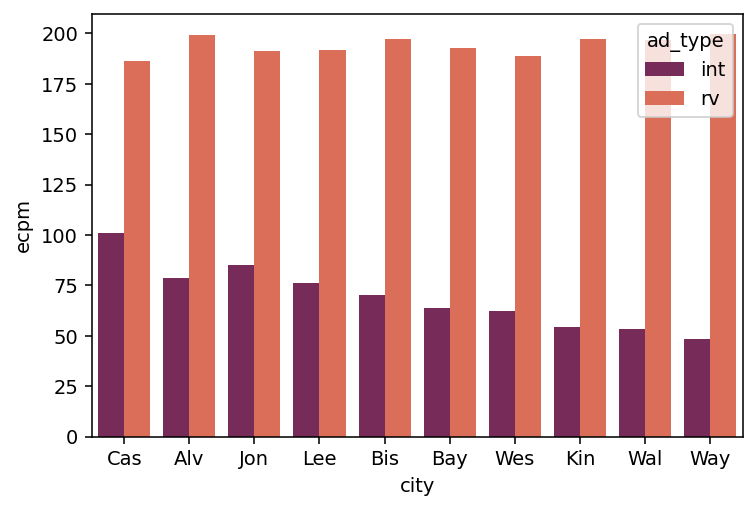

In [138]:
sns.barplot(data=tmp, x='city', y='ecpm', hue='ad_type',order=top_avg_city_ecpm_list, palette='rocket', ci=None)

In [121]:
banner_avg_city_ecpm = ecpm_df[ecpm_df.ad_type == 'banner'].groupby(['ad_type', 'city']).agg({'ecpm': 'mean'}).reset_index().sort_values(by='ecpm', ascending=False)

In [122]:
banner_avg_city_ecpm = banner_avg_city_ecpm.sort_values(by='ecpm', ascending=False).head(10)

In [139]:
tmp = banner_avg_city_ecpm

In [140]:
top_avg_city_ecpm_list = [str[:3] for str in banner_avg_city_ecpm.city.tolist()]

In [141]:
tmp['city'] = tmp['city'].apply(lambda x: x[:3])

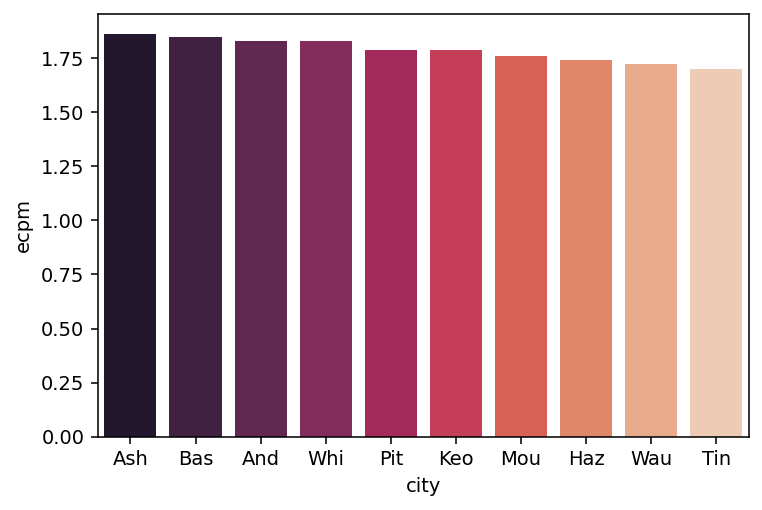

In [142]:
sns.barplot(data=tmp, x='city', y='ecpm', order=banner_avg_city_ecpm.city, palette='rocket', ci=None)

In [49]:
avg_os_ecpm = ecpm_df.groupby(['ad_type', 'os_version']).agg({'ecpm': 'mean'}).reset_index()

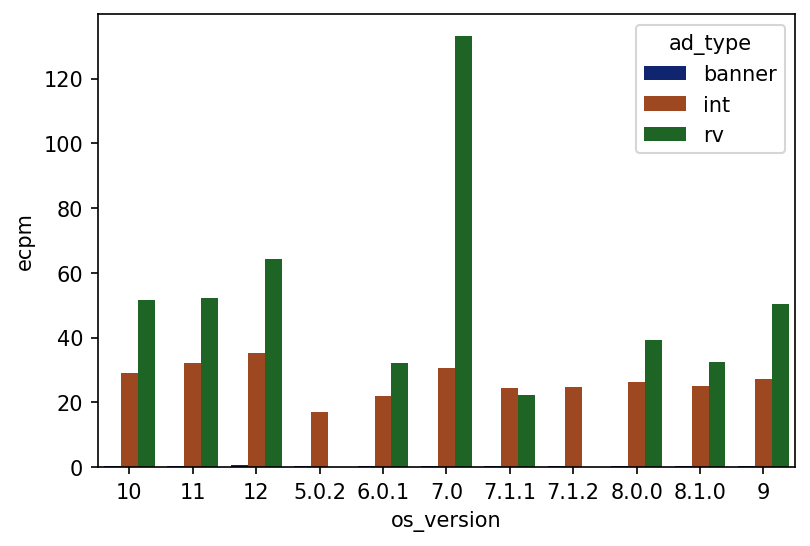

In [51]:
sns.barplot(data=avg_os_ecpm, x='os_version', y='ecpm', hue='ad_type', order=avg_os_ecpm.os_version.unique(), palette='dark', ci=None)

In [52]:
banner_avg_os_ecpm = ecpm_df[ecpm_df.ad_type == 'banner'].groupby(['ad_type', 'os_version']).agg({'ecpm': 'mean'}).reset_index().sort_values(by='ecpm', ascending=False)

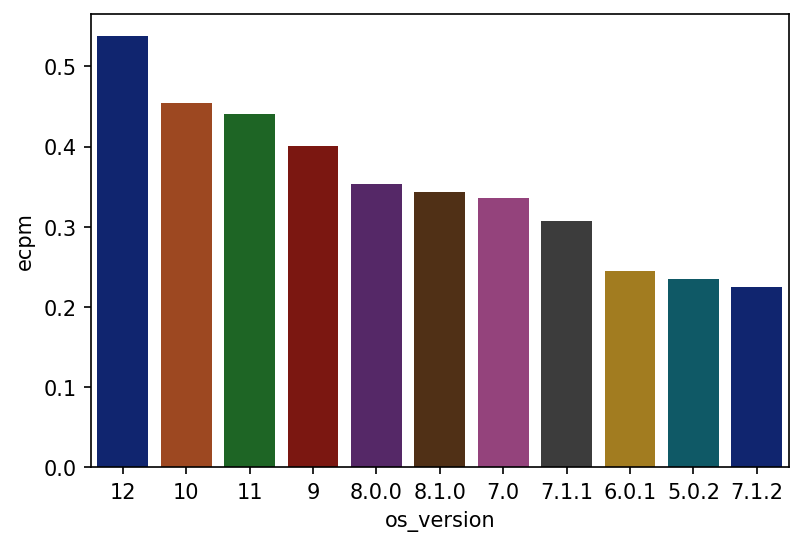

In [53]:
sns.barplot(data=banner_avg_os_ecpm, x='os_version', y='ecpm', order=banner_avg_os_ecpm.os_version, palette='dark', ci=None)

### 1c

In [54]:
ecpm_df['ads_ltv'] = js_df.ads_ltv

In [55]:
sum_ltv = ecpm_df.groupby(['profile_id', 'ad_type', 'city']).agg({'ads_ltv': 'max'}).reset_index()
sum_ltv = sum_ltv.groupby(['ad_type', 'city']).agg({'ads_ltv': 'sum'}).reset_index()

In [56]:
top_city_list = ecpm_df.groupby(['profile_id', 'city']).agg({'ads_ltv': 'max'}).reset_index()
top_city_list = top_city_list.groupby(['city']).agg('sum').reset_index().sort_values(by='ads_ltv', ascending=False)
top_city_list = top_city_list.sort_values(by='ads_ltv', ascending=False).head(10).city.tolist()

In [57]:
tmp = sum_ltv[sum_ltv.city.isin(top_city_list)]

In [58]:
top_city_list = [str[:3] for str in top_city_list]

In [59]:
tmp['city'] = tmp['city'].apply(lambda x: x[:3])

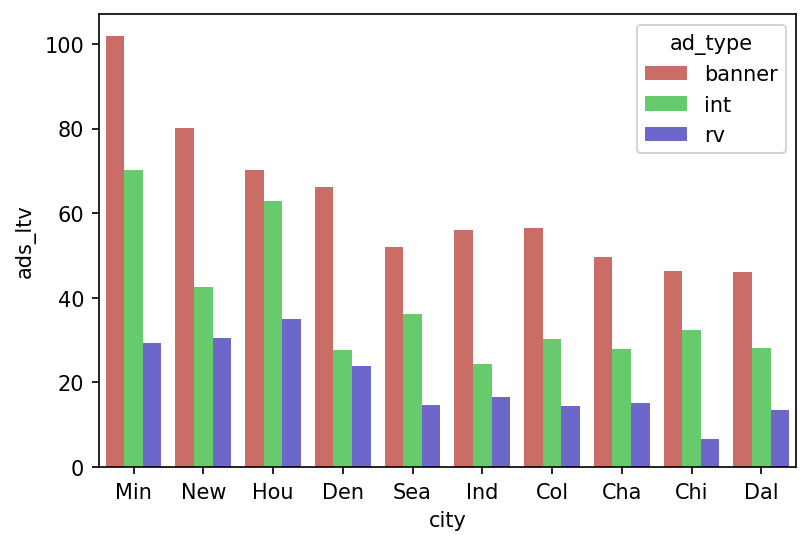

In [60]:
sns.barplot(data=tmp, x='city', y='ads_ltv', hue='ad_type', order=top_city_list, palette='hls', ci=None)

In [61]:
top_banner_city_list = ecpm_df[ecpm_df.ad_type == 'banner'].groupby(['profile_id', 'city']).agg({'ads_ltv': 'max'}).reset_index()
top_banner_city_list = top_banner_city_list.groupby(['city']).agg('sum').reset_index().sort_values(by='ads_ltv', ascending=False)
top_banner_city_list = top_banner_city_list.sort_values(by='ads_ltv', ascending=False).head(10).city.tolist()

In [62]:
tmp = sum_ltv[(sum_ltv.ad_type == 'banner') & (sum_ltv.city.isin(top_banner_city_list))]

In [63]:
top_banner_city_list = [str[:3] for str in top_banner_city_list]

In [64]:
tmp['city'] = tmp['city'].apply(lambda x: x[:3])

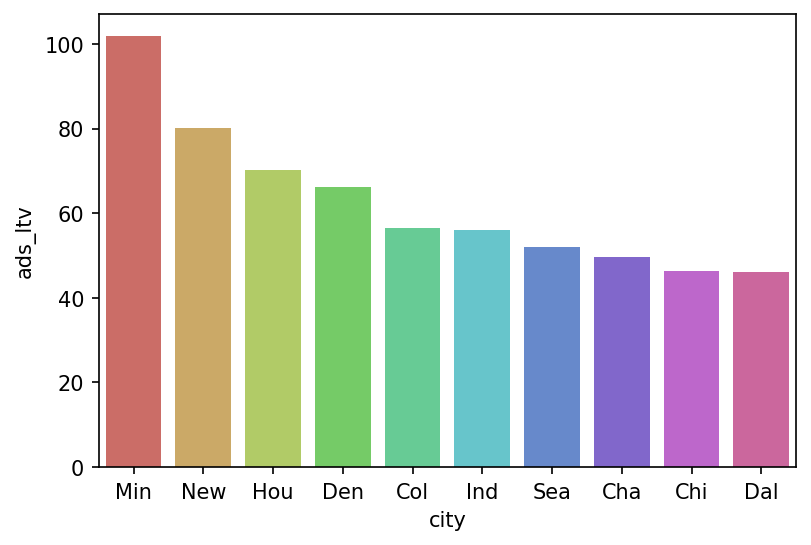

In [65]:
sns.barplot(data=tmp, x='city', y='ads_ltv', order=top_banner_city_list, palette='hls', ci=None)

In [66]:
top_int_city_list = ecpm_df[ecpm_df.ad_type == 'int'].groupby(['profile_id', 'city']).agg({'ads_ltv': 'max'}).reset_index()
top_int_city_list = top_int_city_list.groupby(['city']).agg('sum').reset_index().sort_values(by='ads_ltv', ascending=False)
top_int_city_list = top_int_city_list.sort_values(by='ads_ltv', ascending=False).head(10).city.tolist()

In [67]:
tmp = sum_ltv[(sum_ltv.ad_type == 'int') & (sum_ltv.city.isin(top_int_city_list))]

In [68]:
top_int_city_list = [str[:3] for str in top_int_city_list]

In [69]:
tmp['city'] = tmp['city'].apply(lambda x: x[:3])

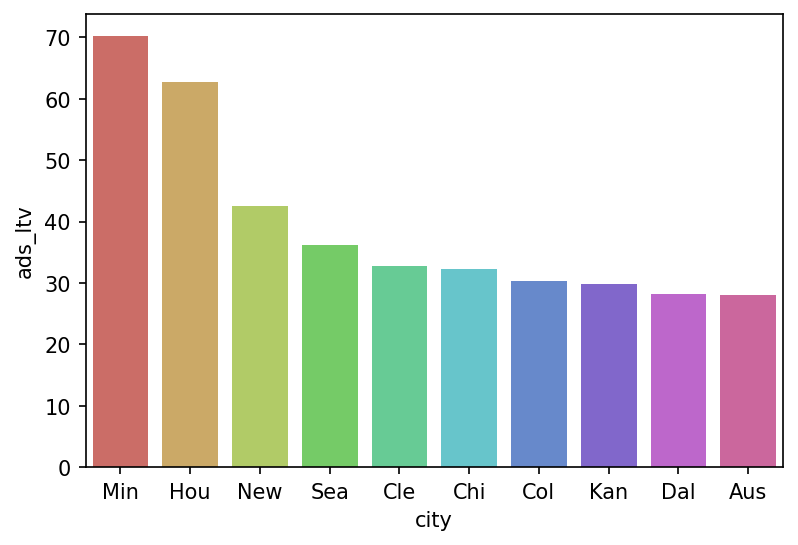

In [70]:
sns.barplot(data=tmp, x='city', y='ads_ltv', order=top_int_city_list, palette='hls', ci=None)

In [71]:
top_rv_city_list = ecpm_df[ecpm_df.ad_type == 'rv'].groupby(['profile_id', 'city']).agg({'ads_ltv': 'max'}).reset_index()
top_rv_city_list = top_rv_city_list.groupby(['city']).agg('sum').reset_index().sort_values(by='ads_ltv', ascending=False)
top_rv_city_list = top_rv_city_list.sort_values(by='ads_ltv', ascending=False).head(10).city.tolist()

In [72]:
tmp = sum_ltv[(sum_ltv.ad_type == 'rv') & (sum_ltv.city.isin(top_rv_city_list))]

In [73]:
top_rv_city_list = [str[:3] for str in top_rv_city_list]

In [74]:
tmp['city'] = tmp['city'].apply(lambda x: x[:3])

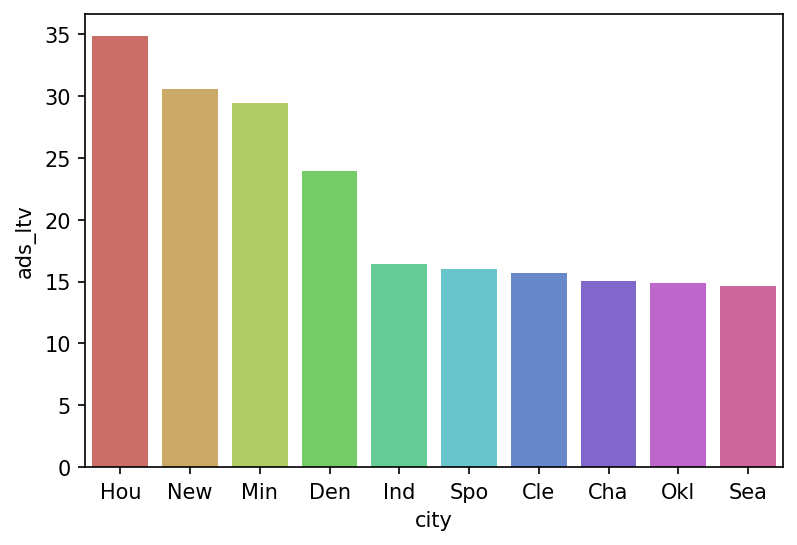

In [75]:
sns.barplot(data=tmp, x='city', y='ads_ltv', order=top_rv_city_list, palette='hls', ci=None)

In [76]:
sum_ltv = ecpm_df.groupby(['profile_id', 'ad_type', 'os_version']).agg({'ads_ltv': 'max'})

In [77]:
sum_ltv = sum_ltv.reset_index()

In [78]:
sum_ltv = sum_ltv.groupby(['ad_type', 'os_version']).agg('sum').reset_index()

In [79]:
plt.rcParams['figure.dpi'] = 200

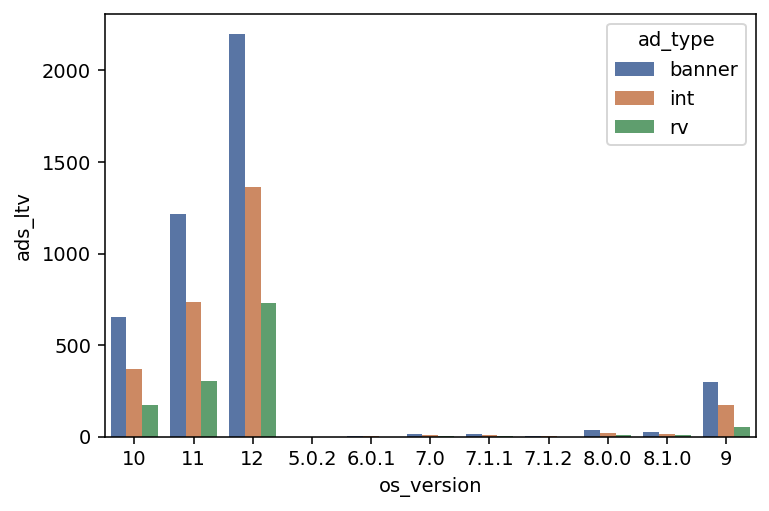

In [148]:
sns.barplot(data=sum_ltv, x='os_version', y='ads_ltv', hue='ad_type', palette='deep')

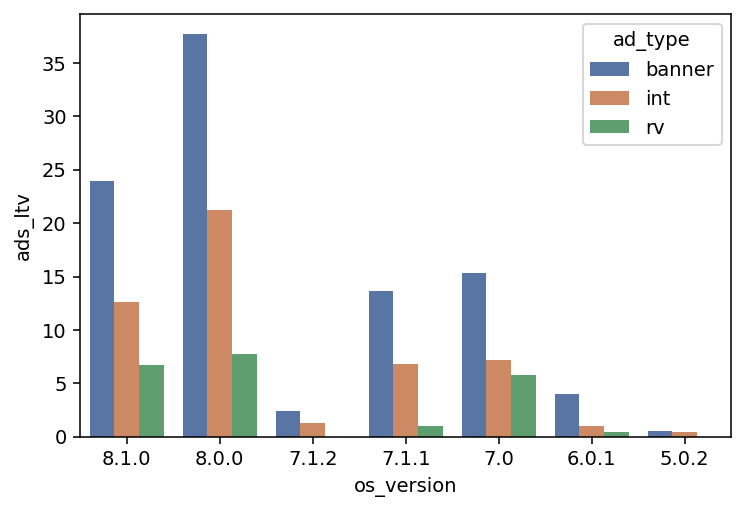

In [145]:
sns.barplot(data=sum_ltv[sum_ltv.ads_ltv < 50], x='os_version', y='ads_ltv', hue='ad_type',order=['8.1.0', '8.0.0', '7.1.2', '7.1.1', '7.0', '6.0.1', '5.0.2'], palette='deep')

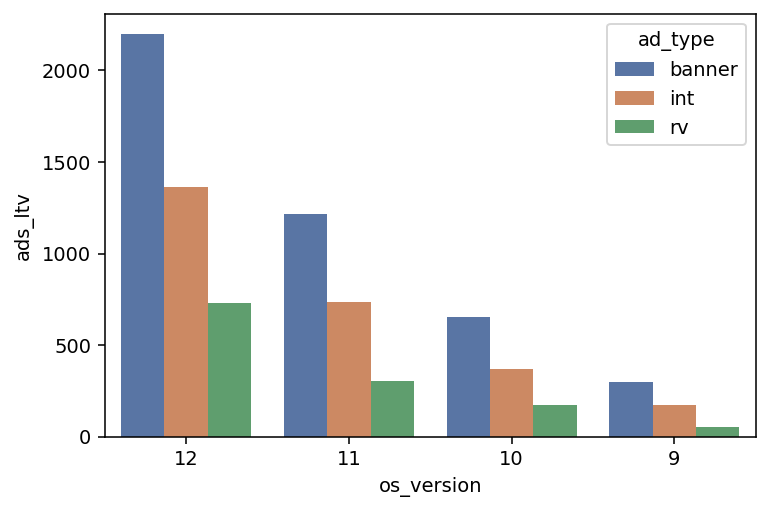

In [146]:
sns.barplot(data=sum_ltv[sum_ltv.ads_ltv >= 50], x='os_version', y='ads_ltv', hue='ad_type', order=['12', '11', '10', '9'], palette='deep')

## 2

In [149]:
general_selection_df = pd.DataFrame()

In [150]:
for i in ad_type_list:
  general_selection_df[i] = ecpm_df[ecpm_df.ad_type == i].reset_index().ecpm

### 2.1

Распределения по городам

In [151]:
most_count_city_list = ecpm_df.groupby('city').agg({'device_manufacturer' :'count'}).reset_index().sort_values(by='device_manufacturer', ascending=False)
most_count_city_list = most_count_city_list[most_count_city_list.device_manufacturer >= 2000].city.tolist()

In [152]:
int_city_selection = ecpm_df[ecpm_df.ad_type == 'int']

In [ ]:
int_city_selection = int_city_selection[['city', 'ecpm']]
int_city_selection

,city,ecpm
3,Cocoa,13.782633
20,NaN,29.002464
39,Jamestown,12.604902
52,Jamestown,11.994717
84,Jamestown,11.904043
...,...,...
859836,Indianapolis,52.502235
859916,Elmira,48.820141
859976,Elmira,45.742691
860020,Elmira,43.487453


In [ ]:
model = ols('ecpm ~ city', data = int_city_selection[int_city_selection.city.isin(most_count_city_list)]).fit() #Oridnary least square method
model.summary() # ANOVA Test

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                   ecpm   R-squared:                       0.101
Model:                            OLS   Adj. R-squared:                  0.095
Method:                 Least Squares   F-statistic:                     18.65
Date:                Sun, 19 Jun 2022   Prob (F-statistic):          1.98e-150
Time:                        21:07:17   Log-Likelihood:                -36166.
No. Observations:                8219   AIC:                         7.243e+04
Df Residuals:                    8169   BIC:                         7.278e+04
Df Model:                          49                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
Intercept                23.2365      2.916      7.970      0.000      17.521      28.952
city[T.Atlanta]           7.1836      3.376      2.128      0.033       0.566      13.801
city[T.Austin]           21.1394      3.330      6.348      0.000      14.611      27.668
city[T.Birmingham]        1.9592      3.260      0.601      0.548      -4.431       8.349
city[T.Boston]            2.8788      3.320      0.867      0.386      -3.630       9.387
city[T.Cape Coral]        6.4350      3.459      1.861      0.063      -0.345      13.215
city[T.Charleston]       24.3295      3.743      6.500      0.000      16.993      31.666
city[T.Charlotte]         5.2468      3.084      1.701      0.089      -0.800      11.293
city[T.Chicago]           4.2719      3.145      1.358      0.174      -1.894      10.437
city[T.Cincinnati]        8.8830      3.862      2.300      0.021       1.313      16.453
city[T.Cleveland]        17.0846      3.199      5.341      0.000      10.814      23.355
city[T.Columbus]         16.5389      3.187      5.189      0.000      10.291      22.787
city[T.Dallas]            9.0759      3.175      2.859      0.004       2.853      15.299
city[T.Dayton]           15.5055      3.676      4.218      0.000       8.299      22.712
city[T.Denver]            8.1236      3.175      2.559      0.011       1.901      14.346
city[T.Detroit]           9.8400      3.289      2.992      0.003       3.394      16.286
city[T.Gallatin]          0.7542      3.210      0.235      0.814      -5.538       7.046
city[T.Gig Harbor]        4.1824      3.534      1.183      0.237      -2.746      11.111
city[T.Houston]          12.6230      3.069      4.113      0.000       6.607      18.639
city[T.Indianapolis]      7.7389      3.197      2.420      0.016       1.471      14.007
city[T.Jacksonville]     12.3934      3.558      3.483      0.000       5.418      19.368
city[T.Jamestown]        -3.1497      4.275     -0.737      0.461     -11.530       5.231
city[T.Kansas City]       9.7700      3.216      3.038      0.002       3.465      16.075
city[T.Las Vegas]        41.1710      3.659     11.252      0.000      33.998      48.344
city[T.Lee's Summit]     20.8635      3.512      5.941      0.000      13.979      27.748
city[T.Los Angeles]      11.4778      3.201      3.586      0.000       5.203      17.753
city[T.Madison]           4.8213      3.743      1.288      0.198      -2.516      12.158
city[T.Mankato]          -3.8793      3.468     -1.119      0.263     -10.677       2.918
city[T.Memphis]          15.5119      3.540      4.382      0.000       8.572      22.451
city[T.Minneapolis]       4.5190      3.028      1.492      0.136      -1.418      10.456
city[T.Nashville]         9.3506      3.577      2.614      0.009       2.338      16.363
city[T.New York]       

### 2.2

In [158]:
banner_os_selection = pd.DataFrame()

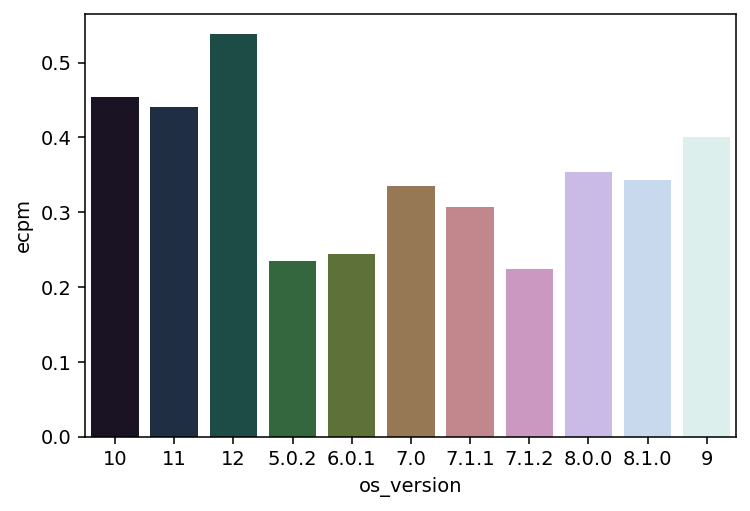

In [159]:
sns.barplot(data=ecpm_df[ecpm_df.ad_type == 'banner'].groupby('os_version').agg({'ecpm': 'mean'}).reset_index(), y='ecpm', x='os_version', palette='cubehelix')

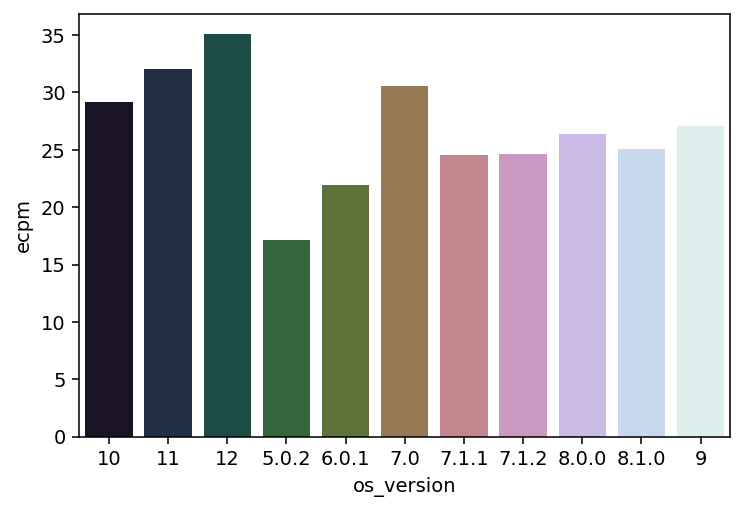

In [160]:
sns.barplot(data=ecpm_df[ecpm_df.ad_type == 'int'].groupby('os_version').agg({'ecpm': 'mean'}).reset_index(), y='ecpm', x='os_version', palette='cubehelix')

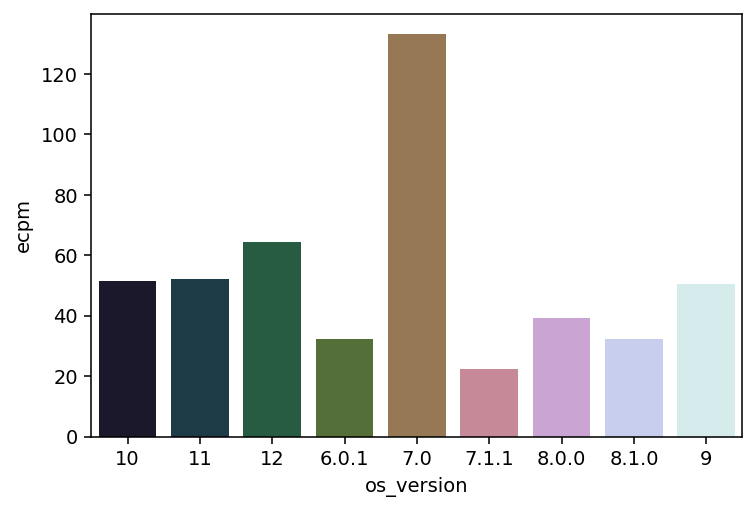

In [161]:
sns.barplot(data=ecpm_df[ecpm_df.ad_type == 'rv'].groupby('os_version').agg({'ecpm': 'mean'}).reset_index(), y='ecpm', x='os_version', palette='cubehelix')

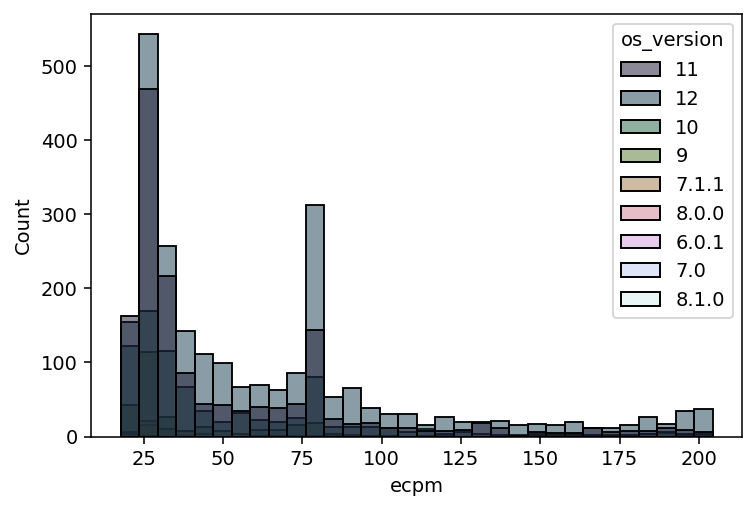

In [156]:
sns.histplot(data=ecpm_df[ecpm_df.ad_type == 'rv'], x='ecpm', hue='os_version', palette='cubehelix')

In [162]:
banner_os_selection = ecpm_df[ecpm_df.ad_type == 'banner']

In [163]:
banner_os_selection.insert(len(banner_os_selection.columns), 'ecpm_Boxcox', boxcox(banner_os_selection.ecpm)[0])

In [166]:
banner_os_selection = banner_os_selection[['os_version', 'ecpm_Boxcox']]
banner_os_selection.ecpm_Boxcox.describe()

count    652772.000000
mean         -0.876176
std           0.690342
min          -2.247262
25%          -1.395278
50%          -0.724311
75%          -0.551240
max           0.686135
Name: ecpm_Boxcox, dtype: float64

In [165]:
model = ols('ecpm_Boxcox ~ os_version', data = banner_os_selection).fit() #Oridnary least square method
model.summary() # ANOVA Test

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            ecpm_Boxcox   R-squared:                       0.026
Model:                            OLS   Adj. R-squared:                  0.026
Method:                 Least Squares   F-statistic:                     1765.
Date:                Mon, 20 Jun 2022   Prob (F-statistic):               0.00
Time:                        07:55:58   Log-Likelihood:            -6.7564e+05
No. Observations:              652772   AIC:                         1.351e+06
Df Residuals:                  652761   BIC:                         1.351e+06
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
Intercept              -0.9167      0.002   -464.547      0.000      -0.921      -0.913
os_version[T.11]       -0.0624      0.003    -23.552      0.000      -0.068      -0.057
os_version[T.12]        0.1463      0.002     63.054      0.000       0.142       0.151
os_version[T.5.0.2]    -0.5055      0.027    -18.520      0.000      -0.559      -0.452
os_version[T.6.0.1]    -0.4547      0.027    -16.617      0.000      -0.508      -0.401
os_version[T.7.0]      -0.2901      0.013    -23.094      0.000      -0.315      -0.265
os_version[T.7.1.1]    -0.4139      0.021    -19.715      0.000      -0.455      -0.373
os_version[T.7.1.2]    -0.5398      0.020    -27.461      0.000      -0.578      -0.501
os_version[T.8.0.0]    -0.1873      0.009    -21.186      0.000      -0.205      -0.170
os_version[T.8.1.0]    -0.2108      0.008    -26.142      0.000      -0.227      -0.195
os_version[T.9]        -0.0848      0.004    -23.827      0.000      -0.092      -0.078
==============================================================================
Omnibus:                     3631.626   Durbin-Watson:                   0.063
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             2630.072
Skew:                          -0.036   Prob(JB):                         0.00
Kurtosis:                       2.697   Cond. No.                         37.4
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [171]:
int_os_selection = ecpm_df[ecpm_df.ad_type == 'int']

In [172]:
int_os_selection.insert(len(int_os_selection.columns), 'ecpm_Boxcox', boxcox(int_os_selection.ecpm)[0])

In [175]:
int_os_selection = int_os_selection[['os_version', 'ecpm_Boxcox']]
int_os_selection.ecpm_Boxcox.describe()

count    30086.000000
mean         1.973524
std          0.186624
min          1.618776
25%          1.830600
50%          1.957751
75%          2.125906
max          2.345900
Name: ecpm_Boxcox, dtype: float64

In [174]:
model = ols('ecpm_Boxcox ~ os_version', data = int_os_selection).fit() #Oridnary least square method
model.summary() # ANOVA Test

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            ecpm_Boxcox   R-squared:                       0.028
Model:                            OLS   Adj. R-squared:                  0.027
Method:                 Least Squares   F-statistic:                     85.56
Date:                Mon, 20 Jun 2022   Prob (F-statistic):          8.03e-175
Time:                        07:58:59   Log-Likelihood:                 8236.5
No. Observations:               30086   AIC:                        -1.645e+04
Df Residuals:                   30075   BIC:                        -1.636e+04
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
Intercept               1.9399      0.003    753.705      0.000       1.935       1.945
os_version[T.11]        0.0290      0.003      8.853      0.000       0.023       0.035
os_version[T.12]        0.0629      0.003     20.820      0.000       0.057       0.069
os_version[T.5.0.2]    -0.1176      0.040     -2.922      0.003      -0.196      -0.039
os_version[T.6.0.1]    -0.0774      0.036     -2.139      0.032      -0.148      -0.006
os_version[T.7.0]       0.0076      0.016      0.469      0.639      -0.024       0.039
os_version[T.7.1.1]    -0.0157      0.024     -0.657      0.511      -0.063       0.031
os_version[T.7.1.2]    -0.0681      0.027     -2.499      0.012      -0.122      -0.015
os_version[T.8.0.0]    -0.0511      0.012     -4.152      0.000      -0.075      -0.027
os_version[T.8.1.0]    -0.0315      0.013     -2.477      0.013      -0.056      -0.007
os_version[T.9]        -0.0215      0.005     -4.717      0.000      -0.030      -0.013
==============================================================================
Omnibus:                     4887.437   Durbin-Watson:                   0.440
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1117.137
Skew:                           0.073   Prob(JB):                    2.61e-243
Kurtosis:                       2.067   Cond. No.                         43.5
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [176]:
rv_os_selection = ecpm_df[ecpm_df.ad_type == 'rv']

In [177]:
rv_os_selection.insert(len(rv_os_selection.columns), 'ecpm_Boxcox', boxcox(rv_os_selection.ecpm)[0])

In [178]:
rv_os_selection = rv_os_selection[['os_version', 'ecpm_Boxcox']]
rv_os_selection.ecpm_Boxcox.describe()

count    5184.000000
mean        1.531477
std         0.064941
min         1.404441
25%         1.479159
50%         1.518873
75%         1.593799
max         1.652044
Name: ecpm_Boxcox, dtype: float64

In [179]:
model = ols('ecpm_Boxcox ~ os_version', data = rv_os_selection).fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            ecpm_Boxcox   R-squared:                       0.036
Model:                            OLS   Adj. R-squared:                  0.035
Method:                 Least Squares   F-statistic:                     24.47
Date:                Mon, 20 Jun 2022   Prob (F-statistic):           2.68e-37
Time:                        08:00:17   Log-Likelihood:                 6915.5
No. Observations:                5184   AIC:                        -1.381e+04
Df Residuals:                    5175   BIC:                        -1.375e+04
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
Intercept               1.5225      0.002    682.572      0.000       1.518       1.527
os_version[T.11]       -0.0002      0.003     -0.062      0.951      -0.006       0.005
os_version[T.12]        0.0210      0.003      8.157      0.000       0.016       0.026
os_version[T.6.0.1]    -0.0255      0.045     -0.565      0.572      -0.114       0.063
os_version[T.7.0]       0.0935      0.032      2.924      0.003       0.031       0.156
os_version[T.7.1.1]    -0.0815      0.032     -2.549      0.011      -0.144      -0.019
os_version[T.8.0.0]    -0.0203      0.009     -2.245      0.025      -0.038      -0.003
os_version[T.8.1.0]    -0.0289      0.012     -2.473      0.013      -0.052      -0.006
os_version[T.9]        -0.0089      0.004     -2.053      0.040      -0.017      -0.000
==============================================================================
Omnibus:                     1813.631   Durbin-Watson:                   0.644
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              266.744
Skew:                           0.141   Prob(JB):                     1.19e-58
Kurtosis:                       1.925   Cond. No.                         59.0
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

## 3

# Доп задание №1

# Доп задание №2

In [ ]:
ecpm_df

,profile_id,os_version,device_manufacturer,device_model,device_type,device_locale,event_name,event_json,event_datetime,event_timestamp,event_receive_datetime,event_receive_timestamp,connection_type,operator_name,country_iso_code,city,ad_type,ecpm,ads_ltv
0,JLjpGzDHBQm,11,Samsung,Galaxy Tab S6,tablet,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-04 20:02:28,1643994148,2022-02-06 17:58:19,1644159499,wifi,NaN,US,Norwalk,banner,0.511508,0.487877
1,JLjpGzDHBQm,11,Samsung,Galaxy Tab S6,tablet,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-04 20:02:45,1643994165,2022-02-06 17:58:19,1644159499,wifi,NaN,US,Norwalk,banner,0.511389,0.488387
2,JLkVacrzHY6,11,Google,Pixel 2,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-05 17:53:05,1644072785,2022-02-06 16:59:29,1644155969,wifi,Verizon,US,Charlotte,banner,0.928597,0.678479
3,JMC6wG3cX0f,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""int"",""placement"":""next_level"",""vie...",2022-02-06 17:09:01,1644156541,2022-02-06 17:09:24,1644156564,wifi,T-Mobile,US,Cocoa,int,13.782633,0.013894
4,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:15:38,1644156938,2022-02-06 17:16:16,1644156976,cell,Verizon,US,NaN,banner,1.660282,0.060571
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
860074,JLSQY2nx1NQ,12,Samsung,Galaxy S21 Ultra 5G,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-03 08:29:27,1643866167,2022-02-03 08:29:37,1643866177,wifi,Verizon,US,Elmira,NaN,NaN,NaN
860075,JLKWwju79CA,12,Samsung,SM-G991U,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-03 02:12:51,1643843571,2022-02-03 02:14:48,1643843688,cell,Verizon,US,Cherry Hill,NaN,NaN,NaN
860076,JLKWwju79CA,12,Samsung,SM-G991U,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-03 02:13:06,1643843586,2022-02-03 02:14:48,1643843688,cell,Verizon,US,Cherry Hill,NaN,NaN,NaN
860077,JLKWwju79CA,12,Samsung,SM-G991U,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-03 02:13:17,1643843597,2022-02-03 02:14:48,1643843688,cell,Verizon,US,Cherry Hill,NaN,NaN,NaN


In [ ]:
ecpm_df.event_datetime = pd.to_datetime(ecpm_df.event_datetime)

In [ ]:
ecpm_df['event_datetime'].dt.hour

0         20
1         20
2         17
3         17
4         17
          ..
860074     8
860075     2
860076     2
860077     2
860078     3
Name: event_datetime, Length: 860065, dtype: int64

In [ ]:
conditions = [((ecpm_df['event_datetime'].dt.hour >= 7) & (ecpm_df['event_datetime'].dt.hour <= 11)),
              ((ecpm_df['event_datetime'].dt.hour > 11) & (ecpm_df['event_datetime'].dt.hour < 18)),
              ((ecpm_df['event_datetime'].dt.hour >= 18) & (ecpm_df['event_datetime'].dt.hour <= 23)),
              ((ecpm_df['event_datetime'].dt.hour < 7))]

In [ ]:
choices = [1, 2, 3, 4]

In [ ]:
ecpm_df['day_time'] = np.select(conditions, choices)

In [ ]:
ecpm_df['day_time'].value_counts()

4    370966
3    238025
1    158454
2     92620
Name: day_time, dtype: int64

In [ ]:
ecpm_df.head(10)

,profile_id,os_version,device_manufacturer,device_model,device_type,device_locale,event_name,event_json,event_datetime,event_timestamp,event_receive_datetime,event_receive_timestamp,connection_type,operator_name,country_iso_code,city,ad_type,ecpm,ads_ltv,day_time
0,JLjpGzDHBQm,11,Samsung,Galaxy Tab S6,tablet,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-04 20:02:28,1643994148,2022-02-06 17:58:19,1644159499,wifi,NaN,US,Norwalk,banner,0.511508,0.487877,3
1,JLjpGzDHBQm,11,Samsung,Galaxy Tab S6,tablet,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-04 20:02:45,1643994165,2022-02-06 17:58:19,1644159499,wifi,NaN,US,Norwalk,banner,0.511389,0.488387,3
2,JLkVacrzHY6,11,Google,Pixel 2,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-05 17:53:05,1644072785,2022-02-06 16:59:29,1644155969,wifi,Verizon,US,Charlotte,banner,0.928597,0.678479,2
3,JMC6wG3cX0f,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""int"",""placement"":""next_level"",""vie...",2022-02-06 17:09:01,1644156541,2022-02-06 17:09:24,1644156564,wifi,T-Mobile,US,Cocoa,int,13.782633,0.013894,2
4,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:15:38,1644156938,2022-02-06 17:16:16,1644156976,cell,Verizon,US,NaN,banner,1.660282,0.060571,2
5,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:15:53,1644156953,2022-02-06 17:16:16,1644156976,cell,Verizon,US,NaN,banner,1.543673,0.061065,2
6,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:16:03,1644156963,2022-02-06 17:16:16,1644156976,cell,Verizon,US,NaN,banner,1.627922,0.063451,2
7,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:16:23,1644156983,2022-02-06 17:17:11,1644157031,cell,Verizon,US,NaN,banner,1.514549,0.063945,2
8,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:16:33,1644156993,2022-02-06 17:17:11,1644157031,cell,Verizon,US,NaN,banner,1.601711,0.066332,2
9,JLzWWTJfi1b,10,Samsung,Galaxy S9,phone,en_US,c_ad_revenue,"{""ad_type"":""banner"",""placement"":"""",""view_index...",2022-02-06 17:16:53,1644157013,2022-02-06 17:17:11,1644157031,cell,Verizon,US,NaN,banner,1.490959,0.066826,2


In [ ]:
ecpm_df.groupby('ad_type').corr()

event_timestamp  event_receive_timestamp  \
ad_type                                                                     
banner  event_timestamp                 1.000000                 0.996636   
        event_receive_timestamp         0.996636                 1.000000   
        ecpm                           -0.103017                -0.101785   
        ads_ltv                         0.021432                 0.019694   
        day_time                       -0.045152                -0.045829   
int     event_timestamp                 1.000000                 0.993346   
        event_receive_timestamp         0.993346                 1.000000   
        ecpm                           -0.111603                -0.111974   
        ads_ltv                         0.039013                 0.036135   
        day_time                       -0.044247                -0.046298   
rv      event_timestamp                 1.000000                 0.995807   
        event_receive_timestamp         0.995807                 1.000000   
        ecpm                           -0.070951                -0.071141   
        ads_ltv                         0.083020                 0.082523   
        day_time                       -0.044985                -0.045332   

                                     ecpm   ads_ltv  day_time  
ad_type                                                        
banner  event_timestamp         -0.103017  0.021432 -0.045152  
        event_receive_timestamp -0.101785  0.019694 -0.045829  
        ecpm                     1.000000  0.126939 -0.023524  
        ads_ltv                  0.126939  1.000000  0.014237  
        day_time                -0.023524  0.014237  1.000000  
int     event_timestamp         -0.111603  0.039013 -0.044247  
        event_receive_timestamp -0.111974  0.036135 -0.046298  
        ecpm                     1.000000  0.190449  0.001709  
        ads_ltv                  0.190449  1.000000  0.029553  
        day_time                 0.001709  0.029553  1.000000  
rv      event_timestamp         -0.070951  0.083020 -0.044985  
        event_receive_timestamp -0.071141  0.082523 -0.045332  
        ecpm                     1.000000  0.256650 -0.036216  
        ads_ltv                  0.256650  1.000000 -0.001053  
        day_time                -0.036216 -0.001053  1.000000

In [ ]:
ecpm_df.groupby('ad_type').agg({'ecpm': ''}).corr()

,ecpm
ecpm,1.0
